# Projet de modélisation numérique
# Etude d'un système critique auto-organisé : évolution d'espèces vivantes
### GENTAZ Angélina, LOUBATON Avigaïl

**Introduction** 

**1. Une modélisation macroévolutive de la sélection naturelle** 

A) Reproduction des figures du chapitre : un modèle simple pour un phénomène complexe 

B) Etude des avalanches et loi de puissance

**2. Ouverture : différenciations, extinctions, populations et dérèglement climatique**

A) Nombre d'espèce variable

B) Importance des espèces variable


**Conclusion**

**Références**

# Introduction

Ce projet de recherche s’appuie sur les travaux du physicien danois Per Bak qui a notamment inventé le terme de “criticalité-autorganisée”. Particulièrement, nous nous aiderons tout au long de ce projet d’un extrait de son livre “Quand la nature s’organise” (1999) dont nous conseillons vivement la lecture avant de s’intéresser plus en détail à notre propre projet (https://drive.google.com/file/d/14qdmvozeysaoMLnqumDTQVv-Op86PPzM/view?usp=sharing).


**Définitions** : Deux termes sont à analyser afin de comprendre en quoi consiste cette théorie :
l’*auto-organisation* et la *criticalité*.

Pour commencer, l’auto-organisation est le maintien d’une structure à l’échelle du système sans
nécessité de l’intervention d’un agent extérieur. En effet, le préfixe « auto », indique une différence
de l’« organisation » : l’organisation émergente ne provient pas de forces extérieures (même si le
système reste ouvert sur son environnement) mais de l’interaction de ses éléments.
L’auto-organisation n’est pas un phénomène prémédité : les entités entrent en interaction sans but
commun préalablement défini, et créent, sans le savoir, une forme particulière d’organisation.

D’autre part, le phénomène de seuil critique est présent pour des systèmes qui changent de phase,
comme l’évolution d’un biotope. Le système devient critique lorsque toutes les entités s’influencent
mutuellement, c’est pourquoi cette notion est intrinsèquement liée à la notion d’auto-organisation. A
l’état critique, le système bifurque et change brutalement de comportement.

**Résumé** : Dans le chapitre « Un projet scientifique pour le dimanche après-midi », le physicien Per
Bak cherche à modéliser de façon simple la théorie de la sélection naturelle, de telle manière à
mettre en évidence l’auto-organisation du système biologique dans un état critique d’équilibre
ponctué. Le modèle est défini de la façon suivante : « *on dispose des nombres aléatoires sur un
cercle. A chaque pas de temps, on remplace le nombre le plus faible, ainsi que les nombres de ses
deux voisins, par de nouveaux nombres tirés au hasard* (p.189) ». Les nombres représentent
l’aptitude de chaque espèce considérée, dont la valeur tend vers 2/3. Il ne s’agit pas tant d’une
quantification de l’adaptation absolue de l’espèce à son environnement mais plutôt d’une
quantification de son intégration stable et auto-cohérente dans un réseau écologique complexe au
cours d’une période de stase (absence d’avalanche). Par ailleurs, la disposition en cercle permet de
rendre compte des interactions qui existent entre les espèces. Enfin, la modification de trois nombres
à chaque pas de temps permet de représenter le phénomène de mutation ou de « pseudo-extinction
» des espèces et l’interdépendance locale des espèces, provoquant des phénomènes d’avalanches.

Plus précisément, la démarche de Per Bak s’appuie notamment sur quatre constats :

1. La théorie de la sélection naturelle a été conçue pour expliquer la microévolution (c’est-à-dire
l’évolution à l’échelle des individus sur une période de temps relativement courte) ;

2. Il n’existe aucun système d’équations exprimant mathématiquement la théorie de la sélection naturelle ;

3. Darwin, comme de nombreux biologistes contemporains, considérait la macroévolution (c’est-à-dire l’évolution à l’échelle des espèces sur une longue période de temps) comme un phénomène linéaire. Les extinctions de masse sont alors expliquées par des chocs brutaux, externes au système biologique (ex : météorite) ;

4. Les données des phénomènes d’extinction de masse de l’histoire de l’évolution biologique terrestre sont compatibles avec une loi de puissance et plus largement avec des phénomènes
de criticalité auto-organisée, comme beaucoup de systèmes inertes dans la nature (tas de
sables, tremblements de terre…).

**Problématique** : L’objectif de ce travail d’étude est de reproduire les principaux résultats du modèle
de Per Bak, d’en comprendre les implications théoriques et d’articuler ces éléments de réflexion avec
les méthodes de modélisation numériques introduites au cours de l’enseignement LU2PY222. La problématique sera donc la suivante : **Peut-on retrouver le caractère critique et auto-organisationnel d’un système biologique grâce au modèle de Per Bak ?**

## 1. Un modélisation macroévolutive de la sélection naturelle

### A. Reproduction des figures du chapitre : un modèle simple pour un phénomène complexe

Pour pouvoir réaliser le modèle d’auto-organisation de Per Bak, nous avons tenté de coder en utilisant uniquement les informations fournies par l'auteur dans son ouvrage - informations par ailleurs assez simplistes.

*N.B : pour simplifier la lecture et le renvoi à l'extrait du livre de Per Bak, le numéro des figures qui suivent correspond au numéro des figures tel qu'affiché dans le livre.*

In [2]:
# Importation des modules
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random

#### Figure 30. Aptitude de l'espèce la moins apte en fonction du nombres de pas d'évolution dans un petit modèle d'évolution à vingt espèces.

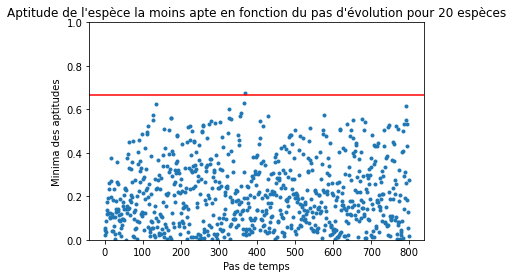

In [3]:
# Fonction dont le rôle est de s'occuper des mutations
def mutation(aptitudes, minimm = None): # on écrit minimm = None ici car plus tard on se servira de cet argument
    indice_du_minimum = np.argmin(aptitudes)
    mini = aptitudes[indice_du_minimum]
    
    if minimm is not None:
        minimm.append(mini)

    gauche = indice_du_minimum - 1
    droite = indice_du_minimum + 1
    #droite1 = indice_du_minimum - 2 # on peut aussi tester l'algo avec un nombre de voisins qui mutent supérieur à 2
    #gauche1 = indice_du_minimum + 2
    #droite2 = indice_du_minimum - 3
    #gauche2 = indice_du_minimum + 3
    
    
    # on réattribue des valeurs aléatoires entre 0 et 1 à l'espèce ayant l'aptitude la plus faible ainsi qu'à ses 2 voisins
    nathan = len(aptitudes)
    aptitudes[gauche%nathan] = random.uniform(0,1)
    aptitudes[droite%nathan] = random.uniform(0,1)
    #aptitudes[gauche1%nathan] = random.uniform(0,1)
    #aptitudes[droite1%nathan] = random.uniform(0,1)
    #aptitudes[gauche2%nathan] = random.uniform(0,1)
    #aptitudes[droite2%nathan] = random.uniform(0,1)
    aptitudes[indice_du_minimum%nathan] = random.uniform(0,1)
    
    return indice_du_minimum

# Simulation de per bak: minima des aptitudes en fonction du temps
def per_bak(nb_espece, pas_de_temps):
    # initialisation
    minimm = []
    aptitudes = np.random.rand(nb_espece)

    j = 0

    while j < pas_de_temps:
        mutation(aptitudes, minimm)
        j = j + 1
        
    return minimm

# réalisation graphe et mise en forme
def draw_graph_per_bak(minimm, title):
    plt.xlabel("Pas de temps")
    plt.ylabel("Minima des aptitudes")

    plt.ylim(0, 1)

    plt.plot(minimm, '.')
    plt.axhline(y = 2/3, color = 'r', linestyle='-') # on trace une ligne horizontale rouge représentant le seuil critique
    plt.title(title)
    plt.show()

# on utilise alors les fonctions préalablement définies pour tracer effectivement le graphe
minimm = per_bak(20, 800) # pour 20 espèces et un pas de temps de 800
draw_graph_per_bak(minimm, "Aptitude de l'espèce la moins apte en fonction du pas d'évolution pour 20 espèces")

#### Figure 30. Aptitude de l'espèce la moins apte en fonction du nombres de pas d'évolution dans un petit modèle d'évolution à trois cent espèces.

La version alternative à 300 espèces illustre mieux la croissance de l’aptitude de l’espèce la moins
apte vers une valeur critique. On le comprend assez facilement, prenons l’exemple du tout premier
point par exemple : avec 300 espèces, on a généré 300 aptitudes au temps 0, donc la plus faible
aptitude a une plus grande probabilité d’être plus faible avec 300 espèces qu’avec 20 espèces.

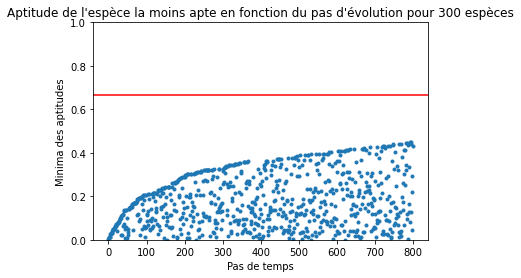

In [4]:
minimm = per_bak(300, 800) # pour 300 espèces et un pas de temps de 800
draw_graph_per_bak(minimm, "Aptitude de l'espèce la moins apte en fonction du pas d'évolution pour 300 espèces")

#### Animation Python de la figure 31 :
Le caractère convergent du système composé de toutes les
espèces vers une aptitude critique n’est pas intuitif. Pour rendre cela plus visuel, nous avons codé en
Python, à l’aide des bibliothèques numpy (pour la gestion des tableaux) et matplotlib (pour les
animations) une simulation avec animation de l’évolution du système.

Voici un exemple obtenu pour 100 espèces :

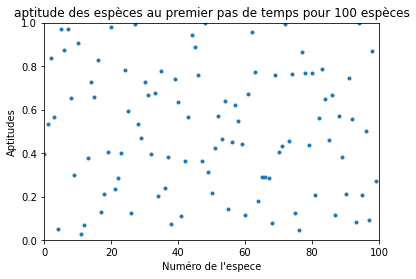

Animation size has reached 20977197 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [5]:
import matplotlib.animation as animation
plt.rcParams["animation.html"] = "jshtml" # pour que le graphe s'affiche

# nous initialisons les aptitudes
def per_bak_aptitudes(nb_espece):
    return np.random.rand(nb_espece)

# on crée une fonction de mutation pour l'animation
def mutation_anim(i, aptitudes):
    mutation(aptitudes)
    line.set_data(np.arange(0, len(aptitudes)), aptitudes) # mise à jour des points au fur et à mesure que l'animation progresse
    return line,

nb_especes = 100 # on prend dans un premier temps un nombre d'espèces pas trop elevé
pas_de_temps = 2000 # on prend un pas de temps relativement grand pour observer l'évolution jusqu'à atteindre le seuil critique

vitesse_anim = 10 # on contrôle ici la vitesse que nous attribuons à l'animation

aptitudes = per_bak_aptitudes(nb_especes)

# on trace la figure non animée lors en début de simulation (pas de temps = 0) en premier lieu
fig = plt.figure()
line, = plt.plot([], [], '.') 

plt.ylim(0, 1)
plt.xlim(0, nb_especes)

plt.xlabel("Numéro de l'espece")
plt.ylabel("Aptitudes")
plt.title("aptitude des espèces au premier pas de temps pour 100 espèces")

# on trace l'animation
ani = animation.FuncAnimation(fig, mutation_anim, frames = pas_de_temps, blit = True, interval = vitesse_anim, repeat = False, fargs=(aptitudes,))
plt.show()
ani

On retrouve l’aspect logarithmique de la plus faible aptitude : en effet, les aptitudes passent très vite la barrière de 0,4 puis l’atteinte de la valeur critique ⅔ est bien plus lente.

#### Figure 31 (non animée). Photographie instantanée des aptitudes dans l'état critique stationnaire du modèle d'évolution.

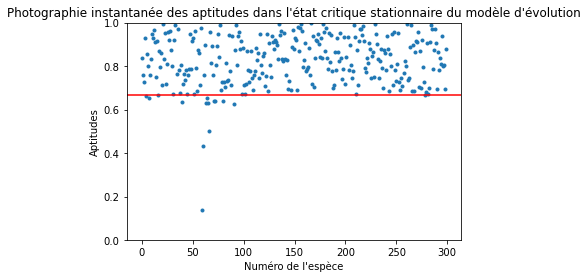

In [6]:
nb_especes = 300
pas_de_temps = 10**5 # on met un pas de temps elevé pour observer les aptitudes des espèces au delà du seuil critique

# Renvoie les aptitudes finales à au temps t = pas_de_temps
def per_bak_en_fonction_espece(nb_especes, pas_de_temps):
    aptitudes = per_bak_aptitudes(nb_especes)
    j = 0
    while j < pas_de_temps:
        mutation(aptitudes)
        j = j + 1
        
    return aptitudes

# affiche les aptitudes finales respectivement aux numéros des espèces 
def draw_graph_per_bak_apt_esp(aptitudes, title):
    plt.xlabel("Numéro de l'espèce")
    plt.ylabel("Aptitudes")

    plt.ylim(0, 1)

    plt.plot(aptitudes, '.')
    plt.axhline(y = 2/3, color = 'r', linestyle='-')
    plt.title(title)
    plt.show()

draw_graph_per_bak_apt_esp(per_bak_en_fonction_espece(nb_especes, pas_de_temps), "Photographie instantanée des aptitudes dans l'état critique stationnaire du modèle d'évolution")

#### figure 32. Structure de l'activité pour le modèle d'évolution. Pour chaque espèce, les points noirs au cours du temps correspondent aux instants où celle-ci subit une mutation. Le temps est mesuré en nombre de pas de temps.

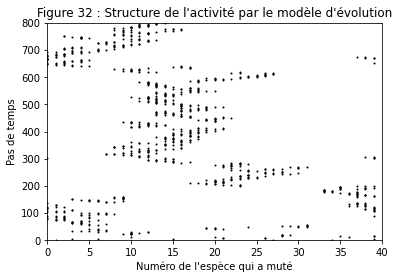

In [7]:
# On trace une figure ayant un motif fractale basée sur les mutations des espèces en fonction du temps
def draw_fractal_mutation(nb_especes, pas_de_temps, title, dot_style='.'):
    aptitudes = per_bak_aptitudes(nb_especes)
    plt.ylim(0, pas_de_temps)
    plt.xlim(0, nb_especes)
    
    j = 0
    plt.title(title)
    
    plt.xlabel("Numéro de l'espèce qui a muté")
    plt.ylabel("Pas de temps")
    
    while j < pas_de_temps:
        indice_mutant = mutation(aptitudes) # dès qu'une espèce donnée subit une mutation, celle-ci est marquée par un point noir en fonction du temps
        plt.plot([indice_mutant], [j], 'k' + dot_style, markersize=1)
        j = j + 1
        
    plt.show()

draw_fractal_mutation(40, 800, "Figure 32 : Structure de l'activité par le modèle d'évolution", 'o')

La figure 33 permet d’identifier le caractère ponctué de l’évolution biologique : des périodes de
stases/d’équilibre, que ponctuent de plus ou moins grandes avalanches, correspondant à de longues
périodes de mutations pour s’adapter au nouveau système. L’espèce n’évolue jamais par “bonds” : si
par exemple sa taille évolue, ce sera par petits paliers (enchaînement de mutations lors d’une
avalanche).

#### figure 33. Équilibres ponctués dans le modèle d'évolution - La courbe montre le nombre de mutations pour une espece untque, c'est-à-dire le nombre de points noirs rencontrés lorsque l'on se déplace suivant la direction verticale à travers la fractale présentée dans la figure 32.

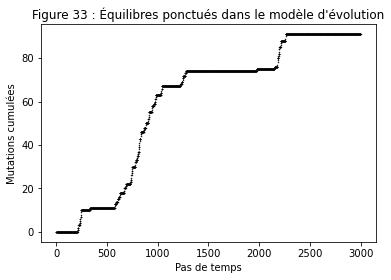

In [8]:
# On trace une figure qui suit l'activité mutationnelle d'une espèce au cours du temps (l'espèce 0 par exemple)
def draw_activity_for_one_mutation(nb_especes, pas_de_temps, indice_mutant_to_follow, title):
    aptitudes = per_bak_aptitudes(nb_especes)
    
    j = 0
    plt.title(title)
    
    plt.xlabel("Pas de temps")
    plt.ylabel("Mutations cumulées")
    
    mutation_counter = 0
    mutation_counter_list = []
    while j < pas_de_temps:
        indice_mutant = mutation(aptitudes)
        if indice_mutant == indice_mutant_to_follow: # s'il s'avère que l'indice de l'espèce qui vient de muter est le même que l'indice de l'espèce qu'on suit : 
            mutation_counter += 1 # alors le compteur de mutation augmente de 1
        mutation_counter_list.append(mutation_counter)
        j = j + 1
    
    plt.plot(mutation_counter_list, 'k.', markersize=1)
    plt.show()
    
draw_activity_for_one_mutation(100, 3000, 0, "Figure 33 : Équilibres ponctués dans le modèle d'évolution")

On comprend bien ici que les lignes horizontales correspondent à des périodes de stase alors que les "sauts" correspondent aux avalanches. Cette modélisation nous donne alors une sorte de fonction en escalier (aussi appelée escalier du diable).

### B. Etude des avalanches et loi de puissance

Nous avons également essayé de retrouver un résultat que donne l’auteur à la page 192.
Il y est dit : « Nous avons enregistré la durée des avalanches, c’est-à-dire le nombre total de mutations
qu’elles contiennent, et nous avons tracé un histogramme du nombre d’avalanches en fonction de leur
taille. Et nous avons trouvé l’indispensable loi de puissance car il y avait en effet des avalanches de
toutes tailles, suivant la loi N(s) = s-τ, τ étant approximativement égal à 1 ».
L’auteur définit la durée des avalanches comme le nombre total de mutations qu’elles contiennent. Si
l’on regarde l’ensemble des espèces, il y a toujours des mutations quelque part : le phénomène des
avalanches est présent à chaque instant et se déplace dans un espace discret qui serait constitué par
les différentes espèces et les affecte les unes après les autres (par groupe de 3).
L’auteur dit en effet à la page 191 : “Les espèces ayant une aptitude plus élevée ont en revanche la vie
belle jusqu’à ce que l’avalanche passe près d’elles et détruise leur existence bienheureuse.”
Ainsi, à l’échelle de toutes les espèces, l’avalanche a une durée infinie (elle se déplace seulement),
nous en avons déduit que la durée des avalanches doit être définie localement.
Ainsi, afin de retrouver la loi de puissance que l’auteur cite, nous montrons ici le code utilisé qu'on pourra ensuite comparer au nombre d'avalanche théorique.

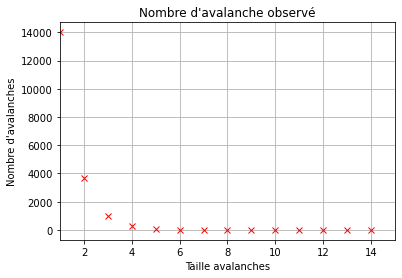

In [10]:
# Calcul les avalanches
def N_observe(nb_especes, pas_de_temps, max_avalanche_x):
    aptitudes = per_bak_aptitudes(nb_especes) # on initialise les aptitutes de toutes les espèces dans une liste
    
    nombre_avalanche_array = np.array([0 for i in range(max_avalanche_x)]) # tableau dont chaque indice va contenir le nombre de l'avalanche
    
    indice_avalanche = 0
    taille_avalanche = 0
    
    indice_avalanche = mutation(aptitudes) # première mutation qui renvoie à un indice qu'on enregistre sur la variable indice_avalanche
    j = 1
    while j < pas_de_temps:
        indice_mutant = mutation(aptitudes) # nouvelle mutation avec nouvel indice et on va comparer les indices
        if indice_mutant == indice_avalanche: # si l'indice de l'espèce qui a muté précedemment est le même que l'indice de l'espèce nouvellement muté cela signifie que l'on a 2 mutations successives et donc :
            taille_avalanche += 1 # la taille de l'avalanche est incrémentée de 1 car il y a eu 2 mutations successsives et on conserve la variable car il pourrait y avoir une nouvelle mutation successive
        elif taille_avalanche > 0: # une fois que les mutations successives s'arrêtent on se retrouve dans ce cas : 
            nombre_avalanche_array[taille_avalanche] += 1 # on incrémente de 1 le nombre d'avalanche lorsqu'il y a eu une/plusieurs mutations(s) successive(s)
            taille_avalanche = 0 # puis on remet les compteurs à 0
            indice_avalanche = indice_mutant
        else:
            taille_avalanche = 0
            indice_avalanche = indice_mutant # s'il n'a pas eu de mutation successive, l'indice qui sera maintenant en mémoire pour la prochaine mutation successive sera l'indice qui vient de muter 
            
        j = j + 1
    
    return (np.arange(1, len(nombre_avalanche_array), 1), nombre_avalanche_array[1:]) # la taille de l'avalanche commence à 1

# Affiche les avalanches
def draw_N_observe(nb_especes, pas_de_temps, max_avalanche_x, title):    
    plt.xlim(1, max_avalanche_x) # on oblige l'abscisse à être entre 1 et l'avalanche maximale
    plt.title(title)
    
    plt.xlabel("Taille avalanches")
    plt.ylabel("Nombre d'avalanches")
    
    t, nombre_avalanche_array = N_observe(nb_especes, pas_de_temps, max_avalanche_x)
        
    plt.plot(t, nombre_avalanche_array, 'rx')
    plt.grid()
    plt.show()
    
draw_N_observe(40, 10**5, 15, "Nombre d'avalanche observé")

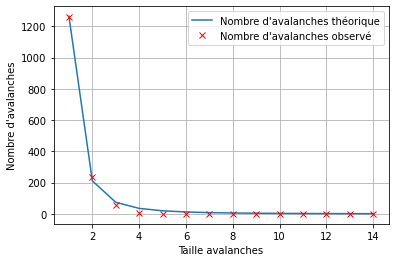

In [12]:
# on compare le nombre d'avalanches observé et le nombre d'avalanches théorique
from scipy.optimize import curve_fit

def N_theorique(t, A, tau):
    return A * (t ** (-tau)) # loi de puissance attendue

t, nombre_avalanche_array = N_observe(40, 10**4, 15)
popt, _ = curve_fit(N_theorique, t, nombre_avalanche_array) # fonction d'optimisation 

plt.xlabel("Taille avalanches")
plt.ylabel("Nombre d'avalanches")

A, tau = popt[0], popt[1] 
plt.plot(t, N_theorique(t, A, tau))
plt.plot(t, nombre_avalanche_array, 'rx')

plt.legend(["Nombre d'avalanches théorique", "Nombre d'avalanches observé"])
plt.grid()
plt.show()

Cette loi de puissance traduit que les avalanches de très grandes tailles sont rares. Ces avalanches sont des événements exceptionnels dans l’histoire des espèces. Il y a par exemple l’explosion du cambrien il y a 500 millions d’années, période durant laquelle de nombreuses nouvelles espèces ont vu le jour remarquablement rapidement et dont l’origine précise est encore un sujet de recherche aujourd’hui. L’auteur cite également l’extinction du permien il y a 250 millions d’années, qui a vu la disparition de près de 96% des espèces.


## 2. Ouverture : différenciations, extinctions et dérèglement climatique

### A. Nombre d'espèces variable

Une limite évidente du modèle de Per Bak est qu’il fonctionne à nombre total d’espèces constant. D’après le physicien, « dans notre modèle, le nombre d’espèces est conservé car, parmi l’espèce originale, seuls les représentants les plus adaptés et plus tard leur version mutée sont conservés (p.185) ». De fait, dans un système contraint en ressources, seules les espèces les plus aptes survivent. Le modèle de M. Kramer, N. Vandewalle et M. Ausloos pallie cette limite en ajoutant des phénomènes de différenciation et d’extinction des espèces. Leurs résultats sont présentés sous la forme d’une arborescence similaire à un arbre phylogénétique au sein de laquelle l’espèce ayant l’aptitude la plus faible se voit attribuer une probabilité $\exp(-f/r)$ d’extinction et une probabilité $1-\exp(-f/r)$ de différenciation en deux espèces, où $f$ est son aptitude et $r$ est la « strength of extinctions». Le caractère auto-organisationnel et critique du système demeure, paramétré par $r$.


### B. Importance des espèces variable

Peut se poser la question de la pondération des espèces par son nombre d’individus, autrement dit la
taille de sa population. Comme on peut le constater avec l’espèce humaine, l’augmentation de sa
population au cours des deux derniers siècles a accru de manière significative la pression sur les
ressources et les habitats naturels si bien que, du fait des pollutions multidimensionnelles (sols, eau,
air) des activités humaines et du dérèglement climatique d’origine anthropique, certains scientifiques
parlent déjà d’une 6
e extinction de masse (sur un temps géologique pourtant infiniment court !). Il
existe donc une interdépendance entre nombre d’espèces et nombre d’individus par espèce que ne
prennent en compte ni le modèle de Per Bak ni celui de Kramer, Vandewalle et Ausloos.
L’astrophysicien François Roddier s’inscrit dans le prolongement de cette vision quand il décrit la
« thermodynamique de l’évolution » et le phénomène du dérèglement climatique comme une
conséquence du caractère auto-organisationnel et critique de la société humaine, et plus largement
du système biologique (défini comme un ensemble de structures dissipatives cherchant à maximiser
le taux de dissipation de leur énergie). De fait, il reprend quatre phases successives d’évolution d’une
espèce :
1. La dépression : installation d’une niche biologique ;
2. L’expansion : multiplication de la population ;
3. La stagflation : stagnation de la population et modification de son environnement pour s’y adapter ;
4. Crises : devenue inadaptée, l’espèce finit par s’éteindre.

Finalement, on pourrait considérer que l’espèce humaine a acquis une aptitude relativement
élevée dans le modèle de Per Bak (supérieure à 2/3) sur un temps relativement court, du fait des
mutations qui lui ont permis de développer des capacités de communication particulières.
Toutefois, les conséquences de ses activités sur l’environnement terrestre, du fait de la prolifération
de sa population et de sa modification de l’environnement pour s’adapter, ont d’abord provoqué
l’extinction de quelques espèces (ce qui correspondrait à la mutation de trois espèces dans le modèle
de Per Bak), puis une avalanche (prolifération de l’avalanche sur toutes les espèces).
Le résultat pourrait être la pseudo-extinction de l’espèce humaine même, finalement atteinte par l’avalanche,
mettant fin à une période de stase évolutive (i.e. un équilibre ponctué) par des crises
(socio-économique, climatique, sanitaire…).
Le phénomène du dérèglement climatique semble donc *a priori* compatible avec le modèle de Per
Bak, bien qu’il suppose quelques précisions.


## Conclusion

Nous avons étudié un modèle simple qui peut rappeler plus familièrement le jeu de la vie : des interactions locales très simples peuvent amener à des résultats complexes - notamment via les avalanches dont nous avons ensuite discuté. On aboutit à une sorte de paradoxe où l'état critique auto-organisé du système est donc un état où le système est globalement métastable (convergence vers le seuil critique) tout en étant localement instable (phénomène d’avalanche). Le modèle de Per Bak nous a permis de mieux comprendre ce qu’était un système critique auto-organisé dans le cadre de l’étude de la sélection naturelle et contribue à renouveler l’étude des dynamiques macro évolutives de la sélection naturelle. Enfin nous avons rendu compte de ses limites et extensions possibles notamment dans le cadre du réchauffement climatique impactant les biotopes.

### Références

Bak (1999). Quand la nature s’organise  « Un projet scientifique pour le dimanche après-midi »

Bak, Sneppen (1993). "Punctuated equilibrium and criticality in a simple model of evolution". Physical Review Letters.

Kramer, Vandewalle, Ausloos (1996). Speciations and Extinctions in a Self-Organizing Critical Model of Tree-Like Evolution. Journal de Physique I, EDP Sciences

Roddier (2020). Thermodynamique de l’évolution : Un essai de thermo-bio-sociologie (Le temps d’apprendre). Editions Parole.

Wikipedia (2021). Bak–Sneppen model. https://en.wikipedia.org/wiki/Bak%E2%80%93Sneppen_model